# Investigate Stamps

Noah Stiegler

6/23/2024

## Setup

In [10]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [11]:
# Ensure notebook is in the right place
import os
os.chdir('/mnt_home/nstieg/BL-COSMIC-2024-proj')
!pwd

/mnt_home/nstieg/BL-COSMIC-2024-proj


In [12]:
# Import regular packages
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import pickle

In [13]:
# Note we're using https://github.com/MydonSolutions/seticore
# not the lacker seticore branch
# This had to be pip installed 
# The command which worked was pip install "git+https://github.com/MydonSolutions/seticore#egg=seticore&subdirectory=python"
from seticore import viewer

In [14]:
# Define where the data is
DATA_PATH = "/datax/scratch/nstieg/"
BFR_PATH = DATA_PATH + "23A-362.sb43789194.eb44583327.60212.544836180554.9.1.AC.C704.0000.bfr5"
STAMPS_PATH = DATA_PATH + "23A-362.sb43789194.eb44583327.60212.544836180554.9.1.AC.C704.0000.raw.seticore.0000.stamps"

In [15]:
# Load in the stamps (with recipes - maybe in bfr5 file?)
# and make sure they all got read in correctly
stamps_gen = viewer.read_stamps(STAMPS_PATH, find_recipe=True)
stamps = []
for stamp in stamps_gen:
    stamps.append(stamp)
    assert(stamp != None)
    assert(stamp.recipe != None)

print("Found:", len(stamps), "stamps")

Found: 49 stamps


/home/nstieg/.local/lib/python3.7/site-packages/seticore/viewer.py:135: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  self.h5 = h5py.File(filepath)


In [16]:
# # Print out all the observed locations
# for stamp in stamps:
#     recipe = stamp.recipe
#     print(recipe.ras, recipe.decs)

So they are all observations of the same thing just as we expected (they're all from the same target). 

Next, let's look at the stamp voltages themselves!

## Investigating first stamp file

In [13]:
# Figure out what's in the first stamp 
stamp = stamps[0]
s = stamp.stamp
print(type(s))
print(s)

<class 'capnp.lib.capnp._DynamicStructReader'>
( sourceName = "WTP14aatinz",
  ra = 6.7897055556284052,
  dec = 3.2790722228831317,
  fch1 = 43255.575422174865,
  foff = 1.9073486328125e-06,
  tstart = 1695648437.9709051,
  tsamp = 0.524288,
  telescopeId = 0,
  numTimesteps = 16,
  numChannels = 524,
  numPolarizations = 2,
  numAntennas = 21,
  data = [-9516.7383, -1121.5806, 6127.8633, -10144.598, 15563.041, 635.79297, -2502.2529, -10630.056, -4512.2812, 8698.3672, 9882.1279, 3304.6104, 962.71484, 4123.7783, 10083.191, 28813.951, -8956.2539, 1221.1675, 8953.3955, 11436.271, -9951.7988, -445.27539, -14405.527, 9902.2129, -22590.719, -13471.038, 9591.3809, 2176.9707, 4661.0635, -8265.3564, 5208.7817, -5834.2246, 30761.227, -15855.088, 8221.4775, -1470.1528, -17414.2, 20903.186, 12559.756, 15226.009, -8512.8047, 12183.147, 7809.6411, 3647.0977, 6673.5508, -3675.6519, -4296.4634, 16029.52, 10191.625, 6391.1309, 1562.9374, -7462.8579, -3765.9771, 10766.445, -6476.2983, -3311.075, 21.8095

In [14]:
# Look at what's in a recipe
def print_recipe(stamp):
    recipe = stamp.recipe
    print("h5", recipe.h5)
    print("ras", recipe.ras)
    print("decs", recipe.decs)
    print("obsid", recipe.obsid)
    print("src_names", recipe.src_names)
    print("time_array", recipe.time_array)
    print("npol", recipe.npol)
    print("nbeams", recipe.nbeams)
    print("cal_all", recipe.cal_all)
    print("nants", recipe.nants)
    print("nchan", recipe.nchan)

In [15]:
print_recipe(stamps[0])

h5 <HDF5 file "23A-362.sb43789194.eb44583327.60212.544836180554.9.1.AC.C704.0000.bfr5" (mode r+)>
ras [1.77754803]
decs [0.0572077]
obsid b'23A-362.sb43789194.eb44583327.60212.544836180554.9.1'
src_names ['3127348761205770496']
time_array [1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+09 1.69564844e+09 1.69564844e+09
 1.69564844e+09 1.69564844e+0

recalculated power: 1.077192e+14
local SNR: 13837.185084537112


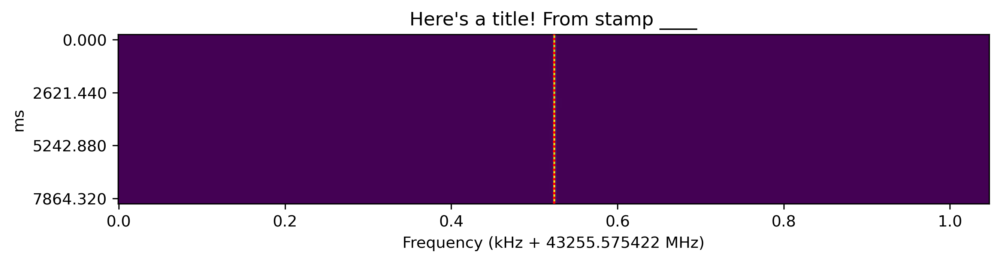

recalculated power: 1.077192e+14
local SNR: 13837.185084537108


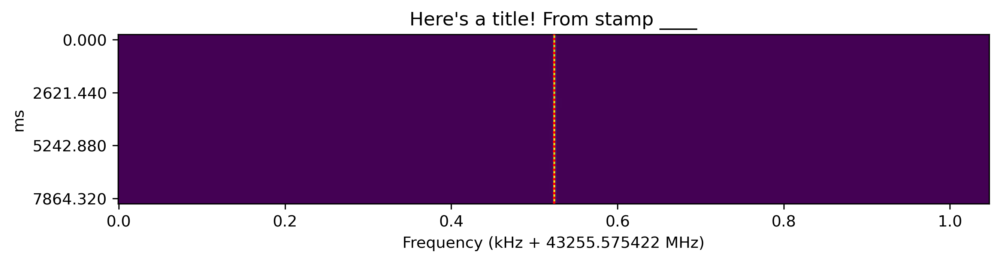

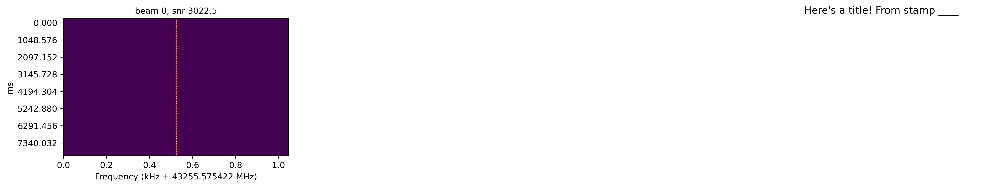

recalculated power: 1.087394e+14
local SNR: 3022.511932481911


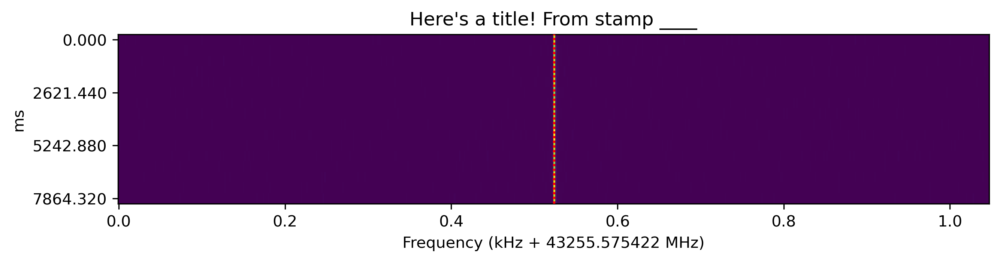

In [25]:
# Show antenna voltages and the incoherent sum
# Also testing to make sure changes to viewer.py work (title and show_signal)
# stamps[0].show_antennas()
stamps[0].show_classic_incoherent(title="Here's a title! From stamp ____", show_signal=True)
stamps[0].show_weighted_incoherent(title="Here's a title! From stamp ____", show_signal=True)
stamps[0].show_beams(title="Here's a title! From stamp ____", show_signal=True)
stamps[0].show_beam(0, title="Here's a title! From stamp ____", show_signal=True)

In [17]:
# Figure out how many beams were formed
print(stamps[0].recipe.nbeams)

1


recalculated power: 1.087394e+14
local SNR: 3022.511932481911


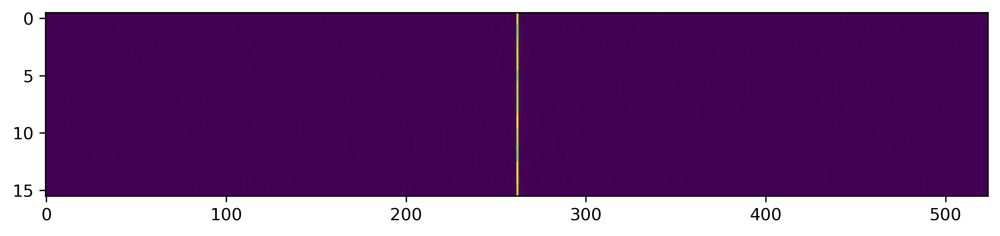

recalculated power: 1.087394e+14
local SNR: 3022.511932481911


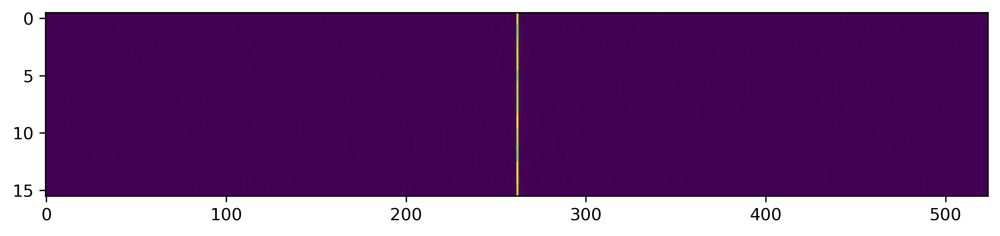

In [18]:
# Look at an individual beam
stamps[0].show_beam(-1) # I guess the last and first element of a 1-element array are the same
stamps[0].show_beam(0)

So the signal comes from just 1 antenna. Not a great sign of an actual observation

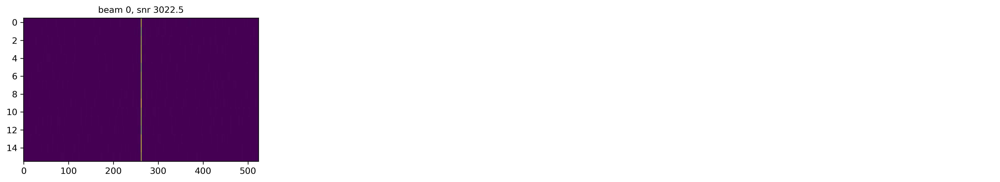

In [19]:
# Look at all the beams together
stamps[0].show_beams()

recalculated power: 1.087394e+14
local SNR: 3022.511932481911


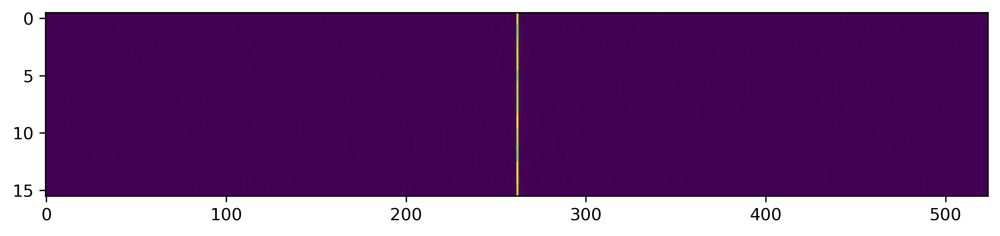

recalculated power: 1.077192e+14
local SNR: 13837.185084537112


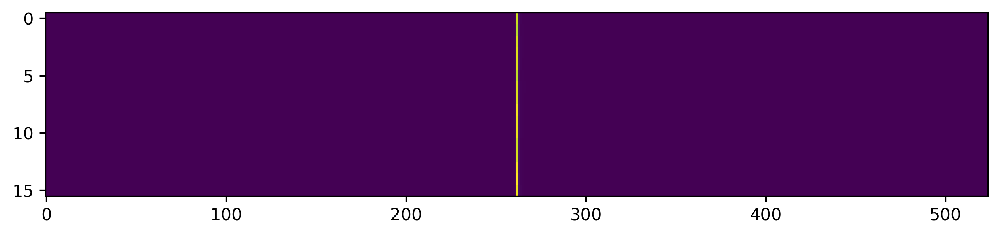

recalculated power: 1.077192e+14
local SNR: 13837.185084537108


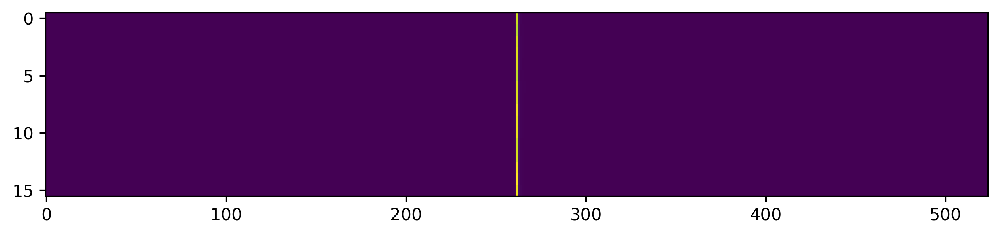

In [20]:
# Look at coherent, incoherent, and incoherent weighted
stamps[0].show_beam(0)
stamps[0].show_classic_incoherent()
stamps[0].show_weighted_incoherent()

3.1529149661461515
43274.80676449054
8.176507949829102


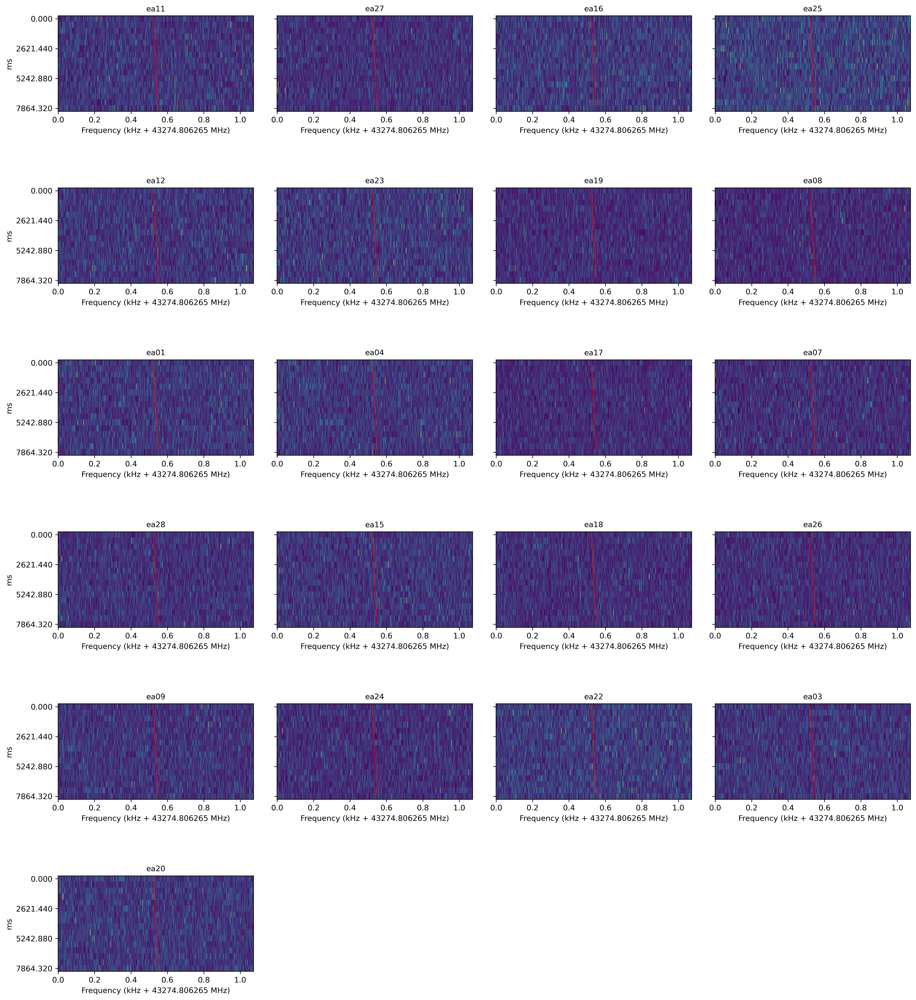

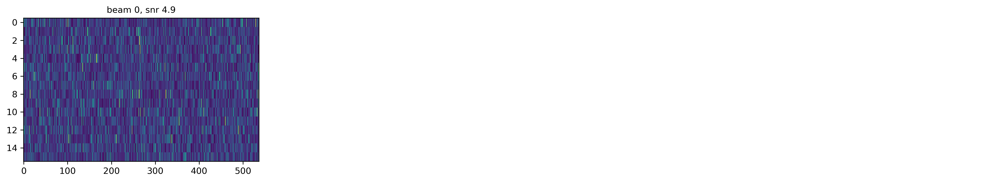

recalculated power: 2.804427e+11
local SNR: -3.294640337077011


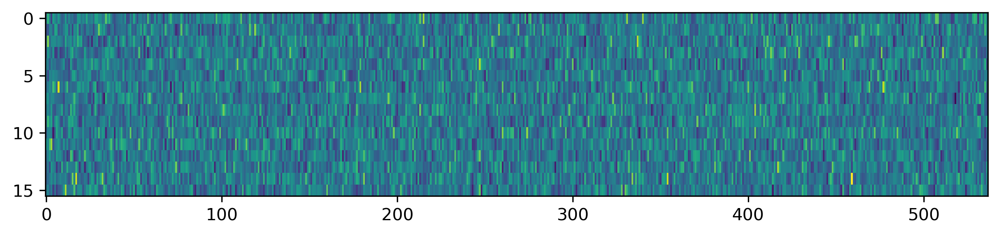

recalculated power: 2.804427e+11
local SNR: -3.2946403370770088


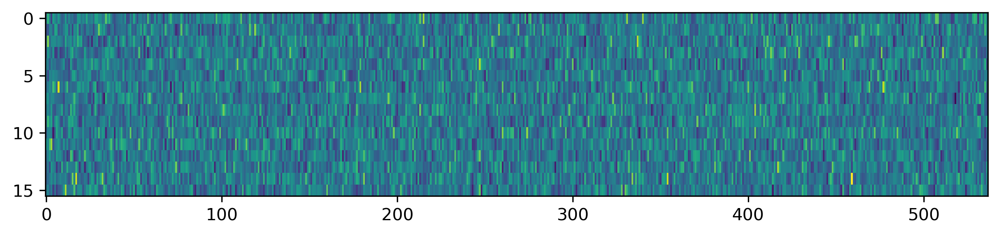

In [39]:
# Try to plot the signal on top of the voltages
stamp = stamps[33]
stamp.show_antennas(show_signal=True)
stamp.show_beams()
stamp.show_classic_incoherent()
stamp.show_weighted_incoherent()


## Investigate metadata from all stamps

In [24]:
# print_recipe(stamps[0])
# print(stamps[0].stamp)
frequencies = [stamp.stamp.signal.frequency for stamp in stamps]
drift_rates = [stamp.stamp.signal.driftRate for stamp in stamps]
snrs = [stamp.stamp.signal.snr for stamp in stamps]
powers = [stamp.stamp.signal.power for stamp in stamps]
incoherent_powerse = [stamp.stamp.signal.incoherentPower for stamp in stamps]

In [25]:
print(len(frequencies))
print(len(np.unique(frequencies)))
print(type(frequencies))

49
49
<class 'list'>


In [26]:
# Frequencies of the first four hits in the 32M dataset
# These four are all in this stamp file (or should be)
frequencies_of_first_four = [
    43255.9054468941,
    43255.65711010211,
    43255.68989742511,
    43256.36075199359
]

# Want to find which of the stamps it is, but they're jumbled up
# Check to see which index corresponds to which frequency
def find_index(frequency):
    for i, freq in enumerate(frequencies):
        if freq == frequency:
            return i
    return -1

# Find the indices
indices_of_hits = [find_index(freq) for freq in frequencies_of_first_four]
print(indices_of_hits)

[28, 4, 24, 14]


In [27]:
for i, stamp in enumerate(stamps):
    s = stamp.stamp
    print(i, s.signal.driftRate)

0 0.0
1 0.0
2 0.0
3 0.0
4 -0.24253192047278088
5 0.0
6 0.0
7 0.0
8 0.0
9 0.0
10 0.0
11 0.0
12 0.0
13 0.0
14 0.0
15 0.0
16 0.0
17 0.0
18 0.0
19 0.0
20 0.0
21 0.0
22 0.0
23 0.0
24 0.0
25 0.0
26 0.0
27 0.0
28 -49.71904369692008
29 0.24253192047278088
30 -4.850638409455618
31 -40.745362639427185
32 -44.3833414465189
33 3.1529149661461515
34 29.83142621815205
35 42.92814992368221
36 -13.581787546475729
37 -29.346362377206486
38 38.80510727564494
39 5.820766091346741
40 0.0
41 0.0
42 -0.24253192047278088
43 0.0
44 0.0
45 0.0
46 0.0
47 0.0
48 -13.824319466948511


## Investigate hits

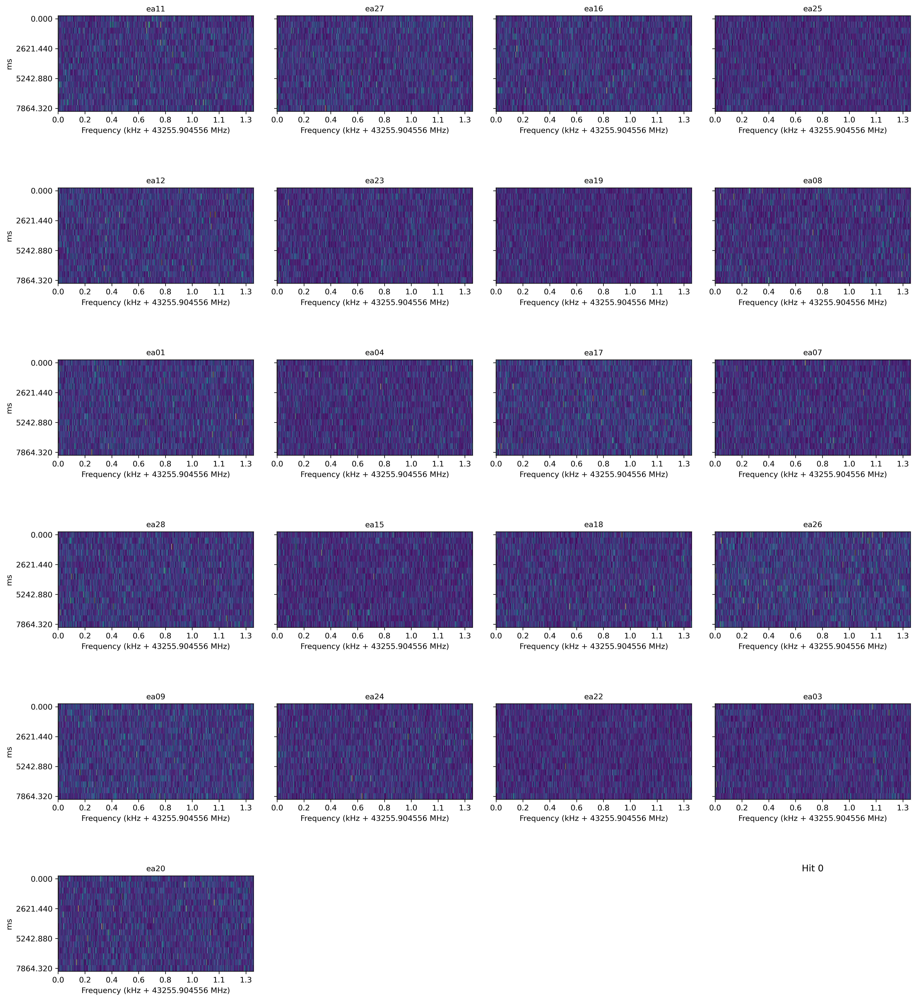

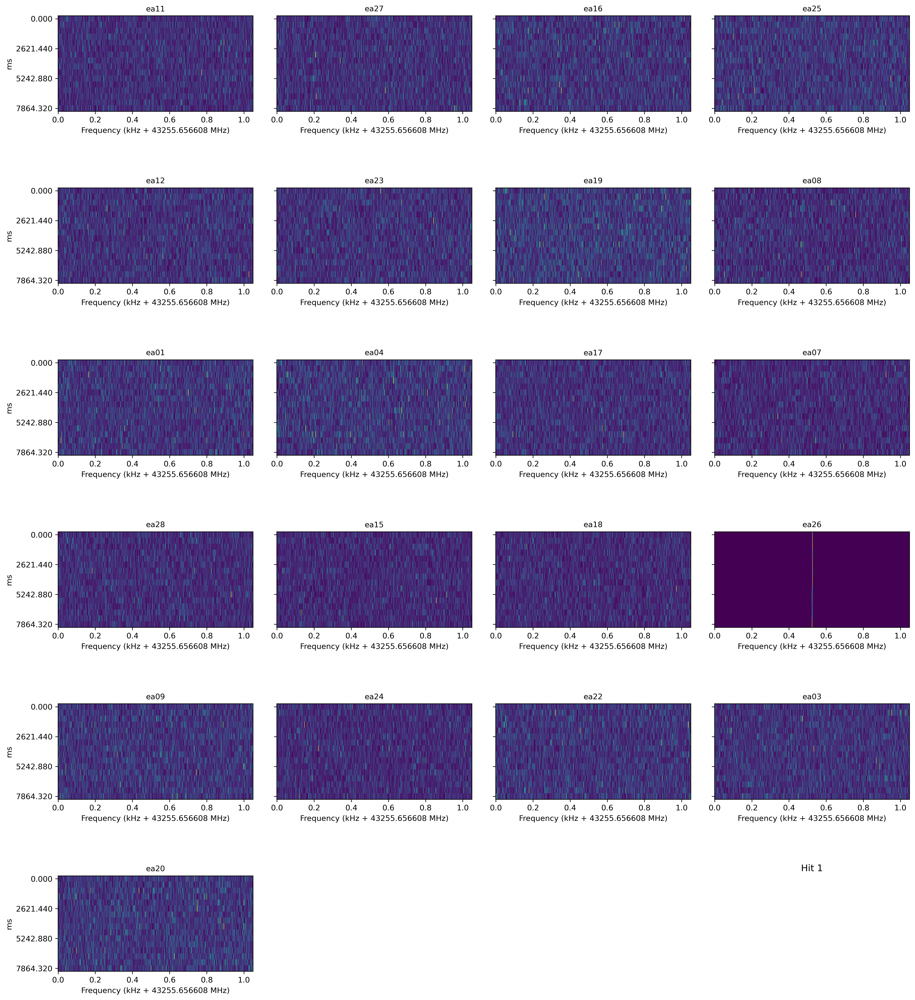

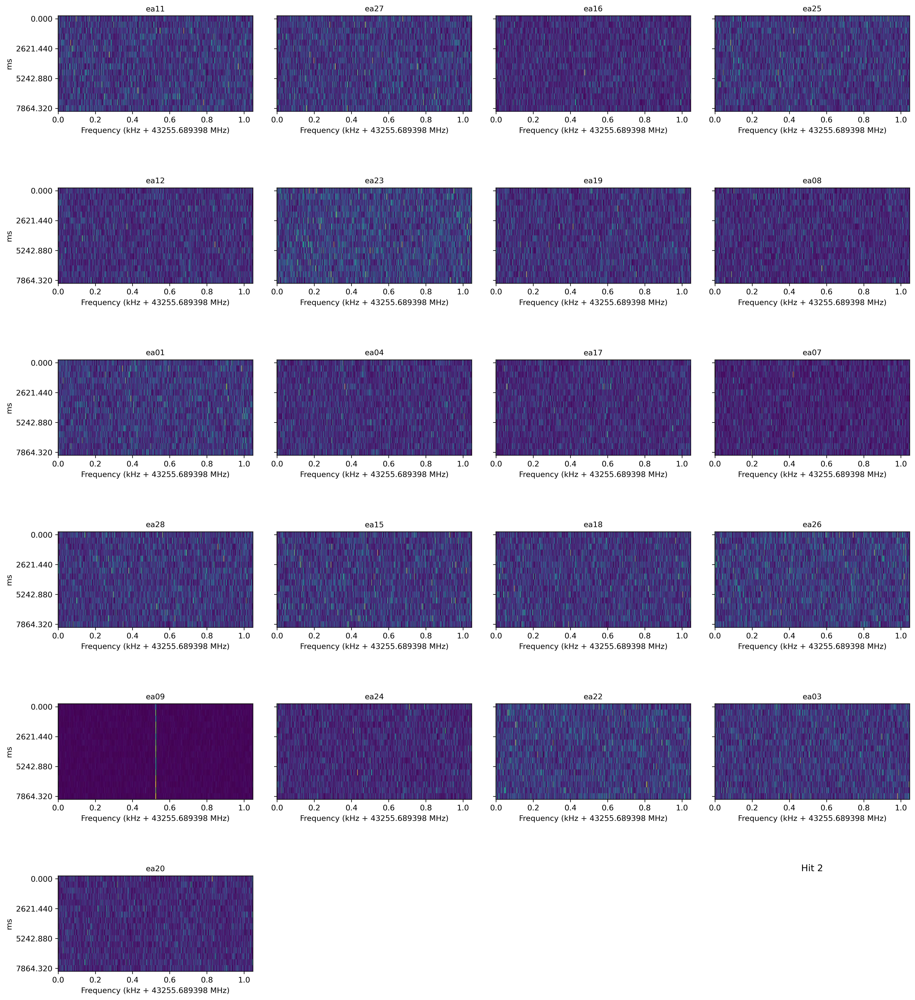

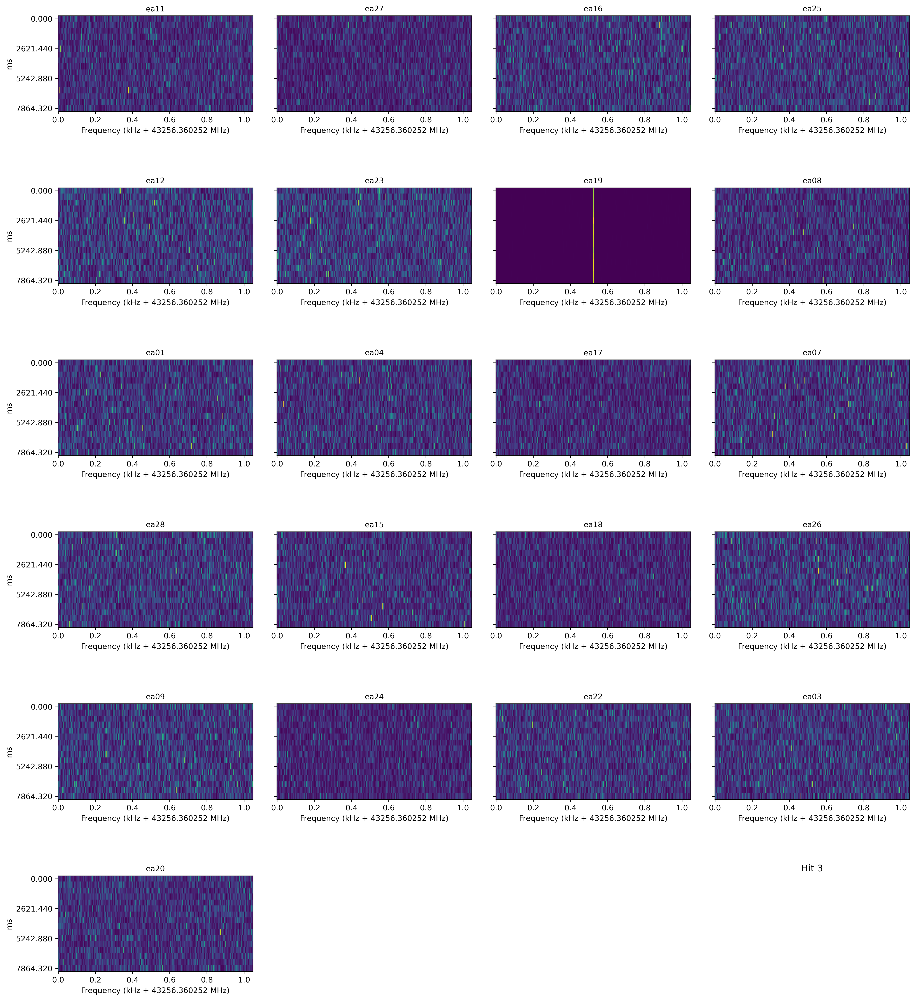

In [28]:
for i, ihit in enumerate(indices_of_hits):
    stamp = stamps[ihit]
    stamp.show_antennas(f"Hit {i}")
    # TODO, plot coherent/incoherent beam

## Invesigate all stamps in stamp file

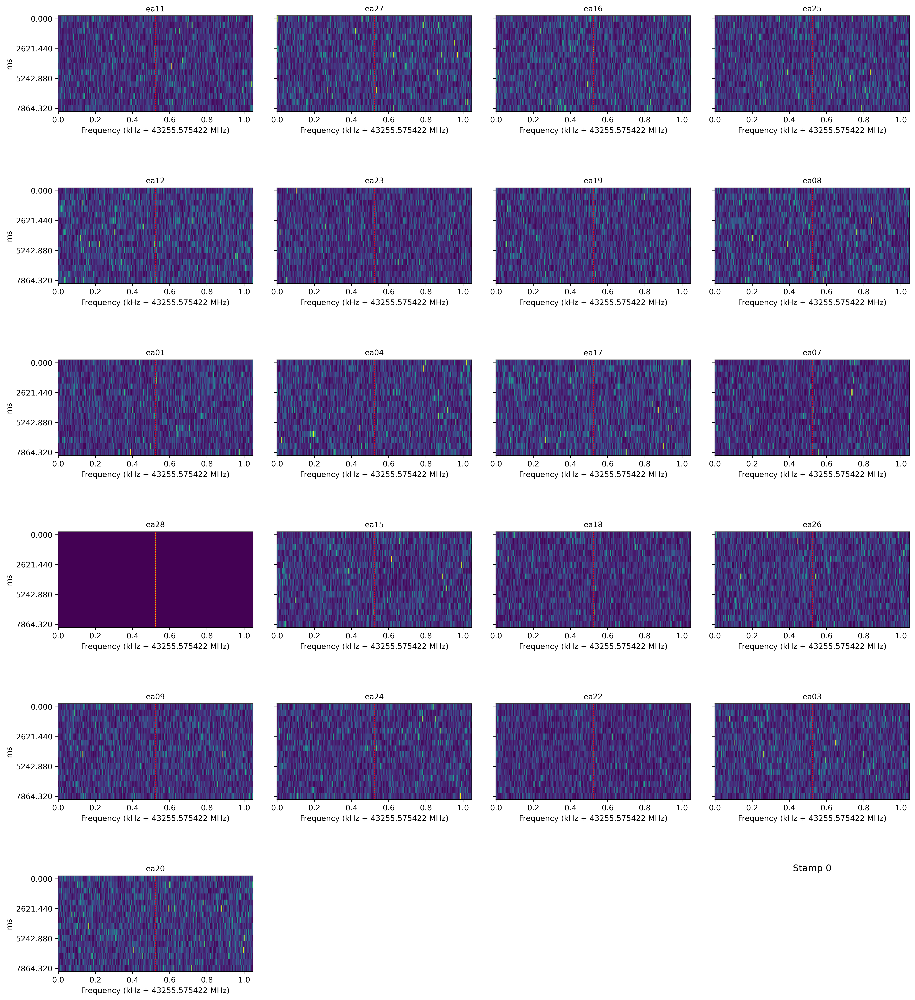

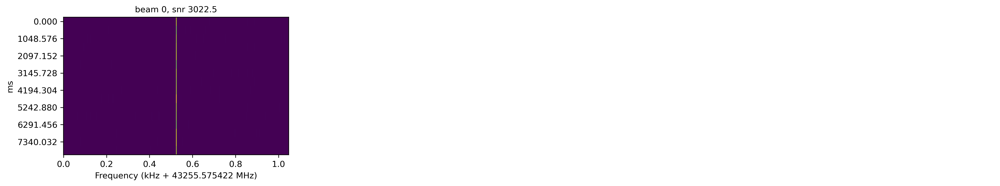

recalculated power: 1.077192e+14
local SNR: 13837.185084537112


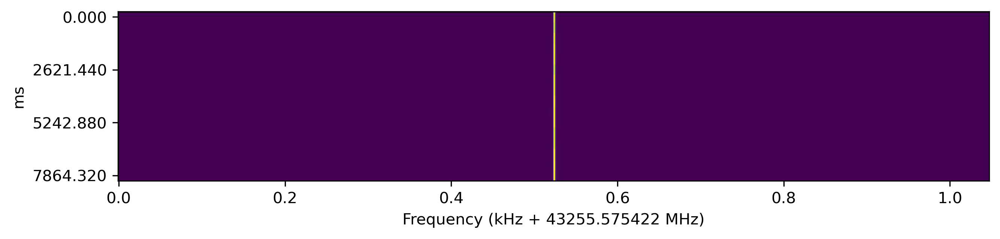

recalculated power: 1.077192e+14
local SNR: 13837.185084537108


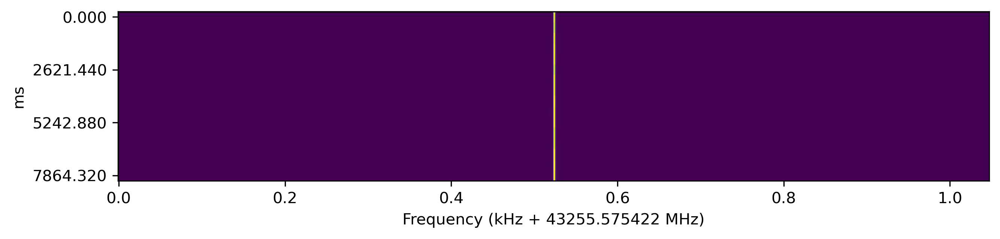

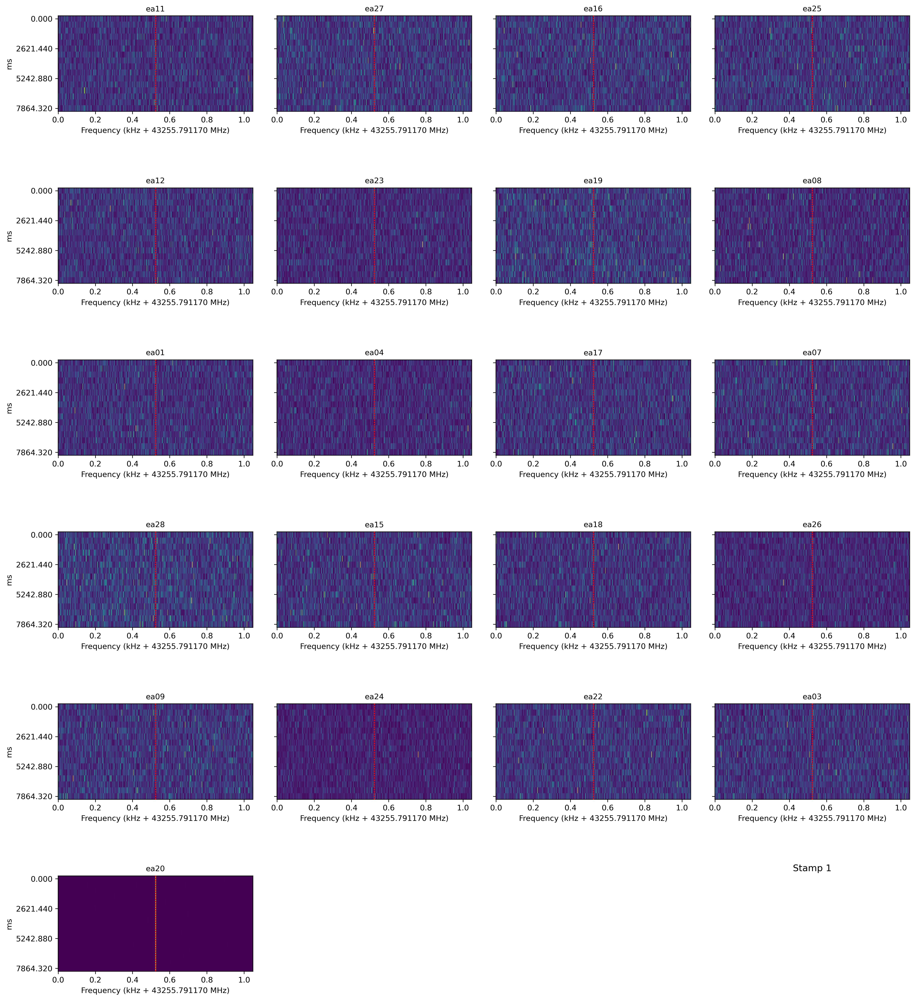

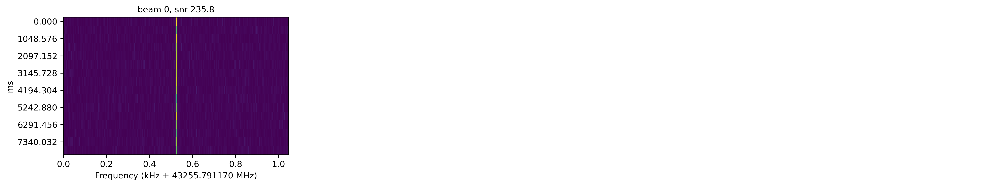

recalculated power: 1.509710e+13
local SNR: 1425.1919684082952


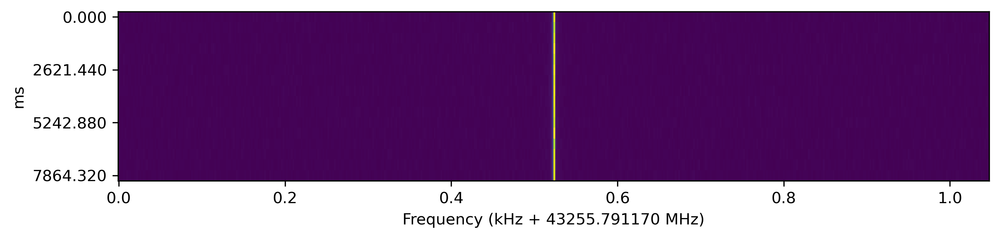

recalculated power: 1.509710e+13
local SNR: 1425.1919684082948


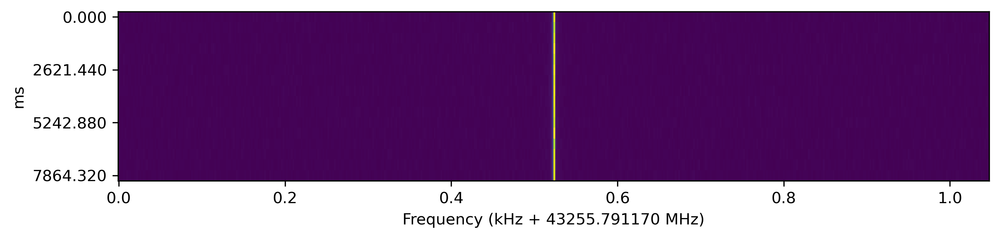

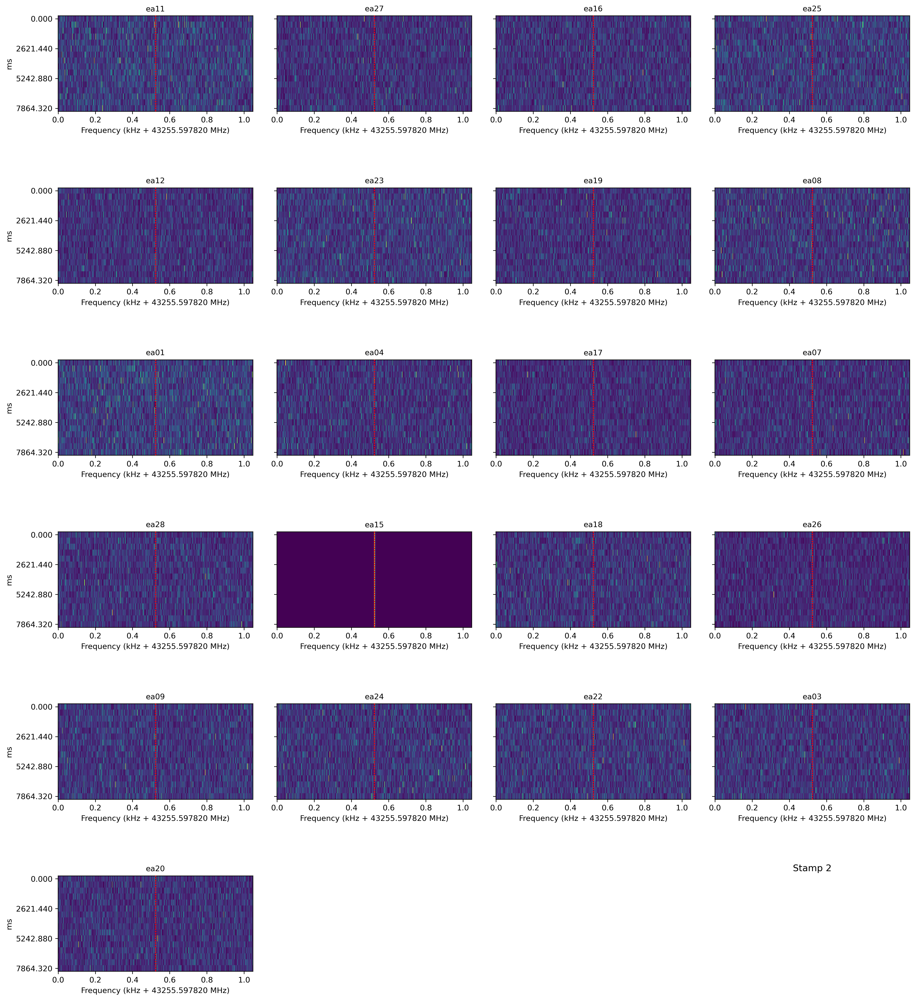

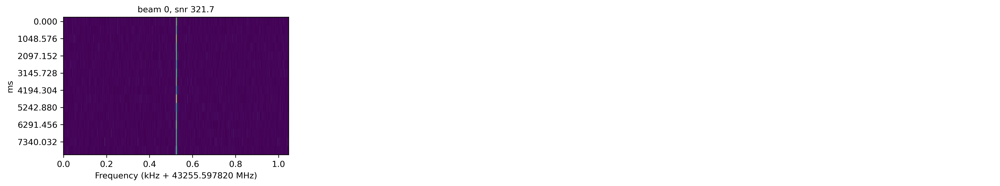

recalculated power: 1.261375e+13
local SNR: 1355.4313038315065


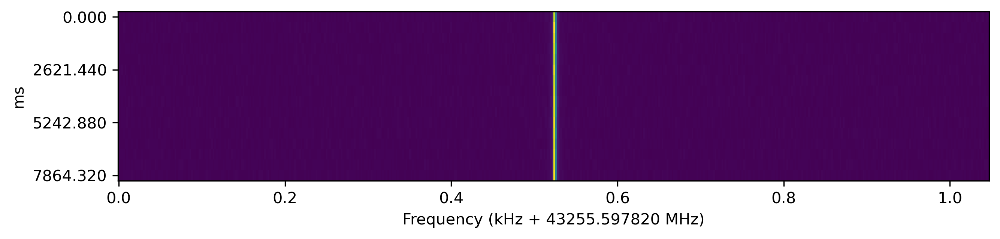

recalculated power: 1.261375e+13
local SNR: 1355.4313038315076


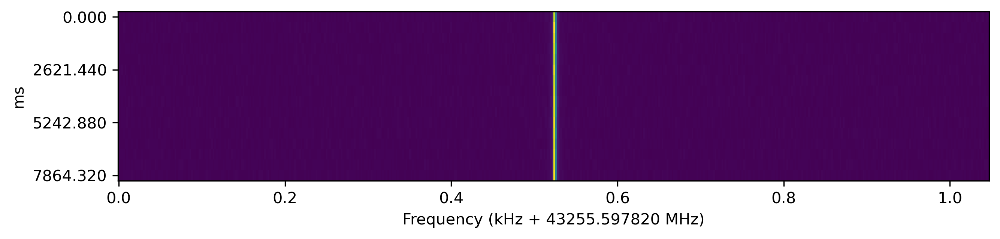

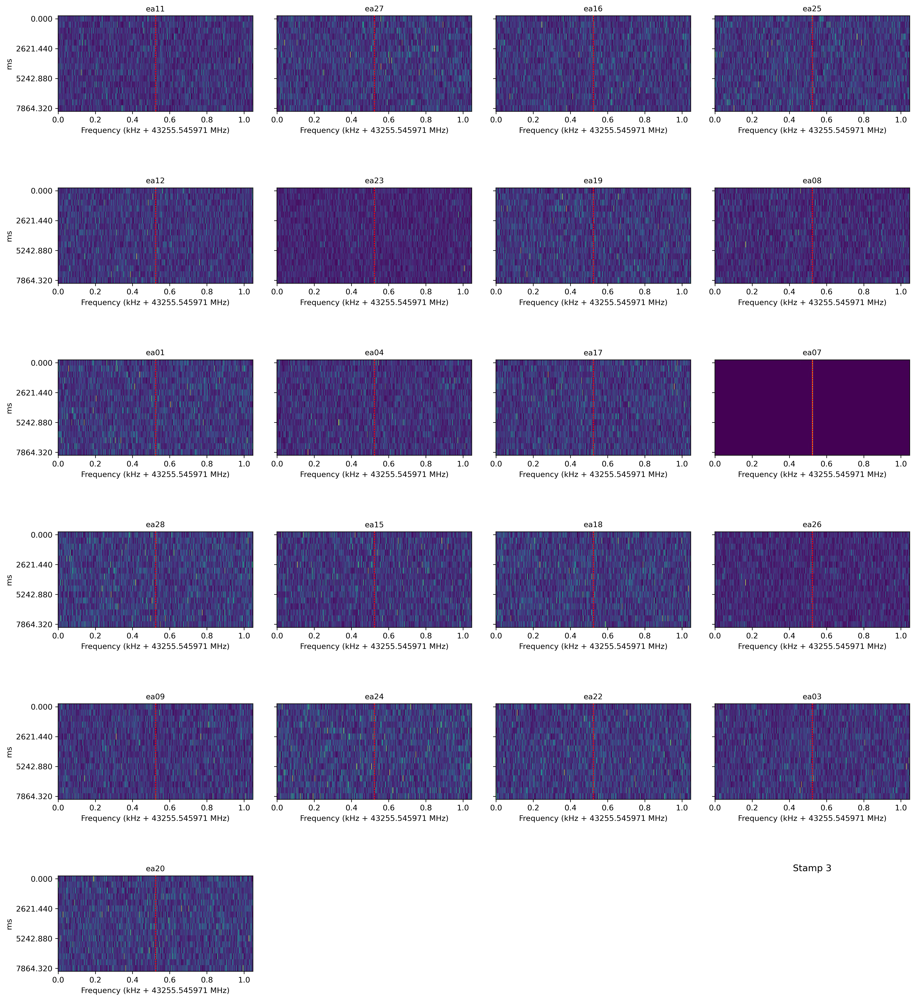

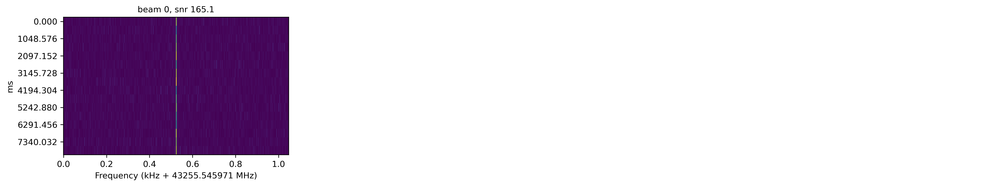

recalculated power: 7.538465e+12
local SNR: 947.2950959213282


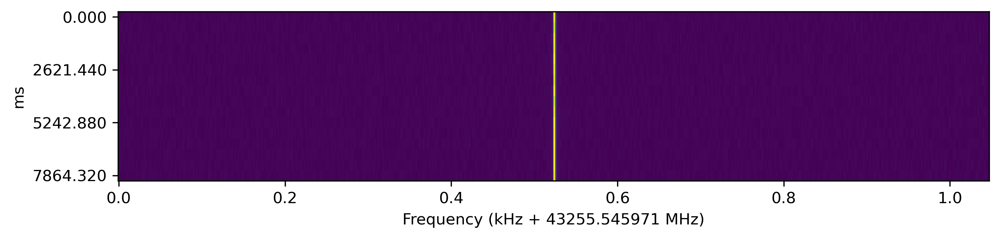

recalculated power: 7.538465e+12
local SNR: 947.2950959213275


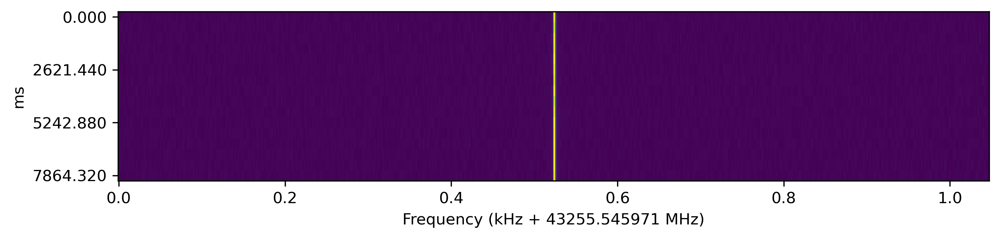

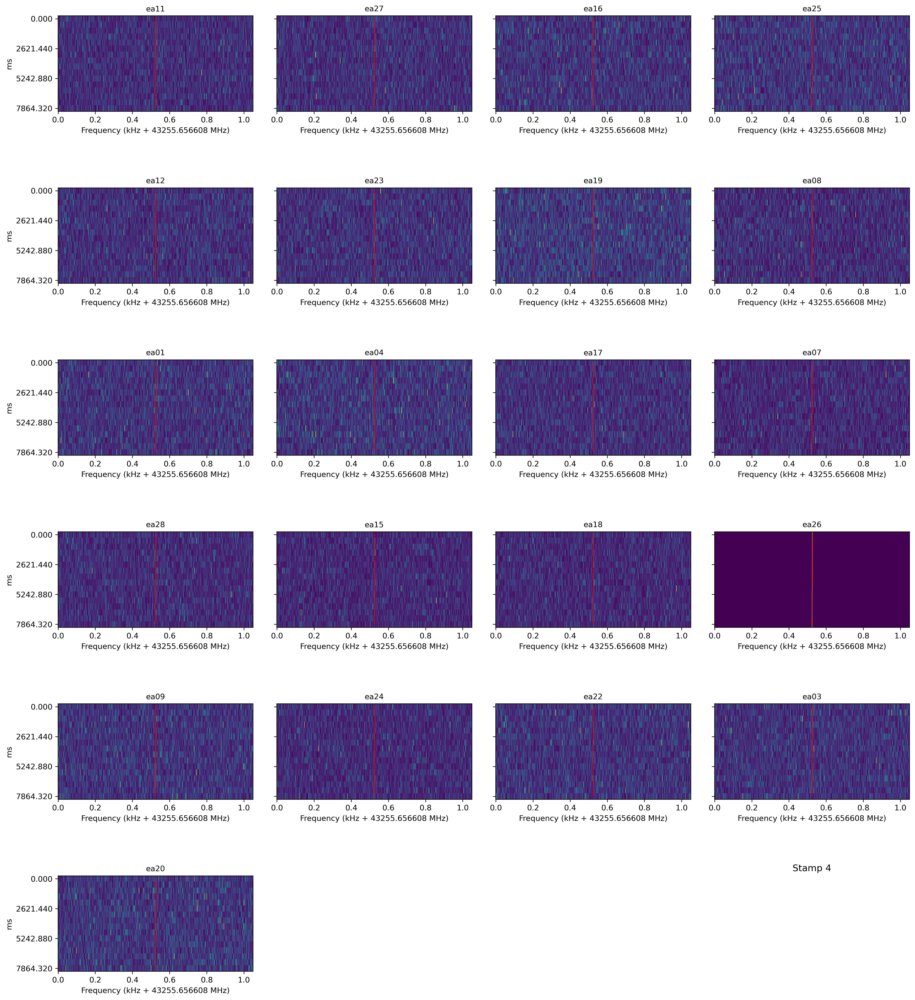

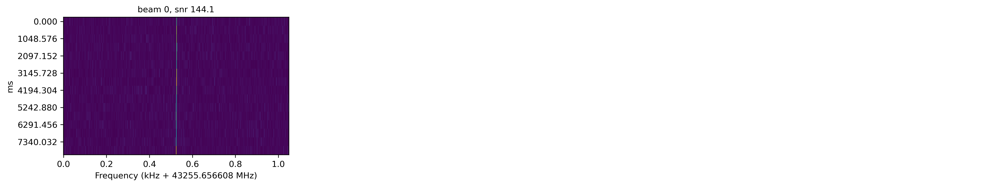

recalculated power: 7.432709e+12
local SNR: 845.0719460939467


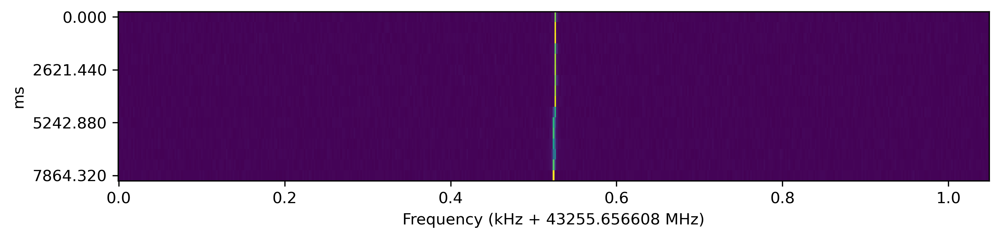

recalculated power: 7.432709e+12
local SNR: 845.071946093947


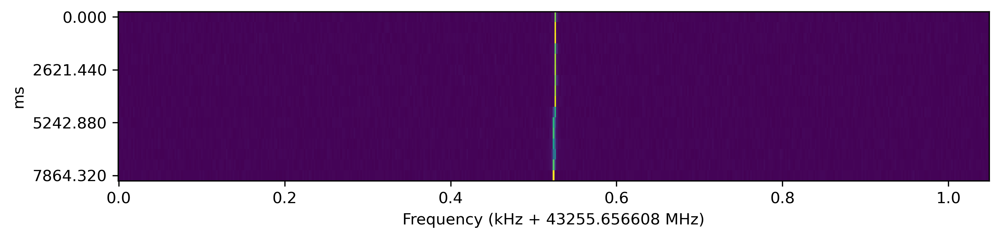

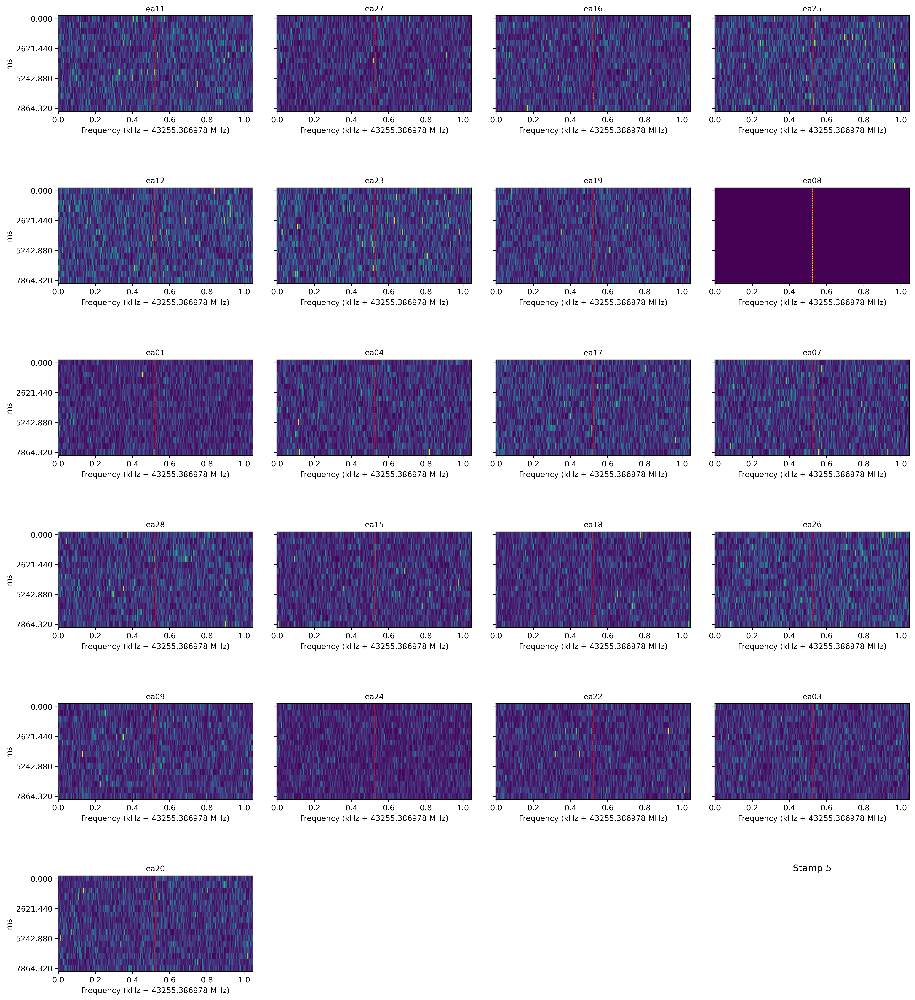

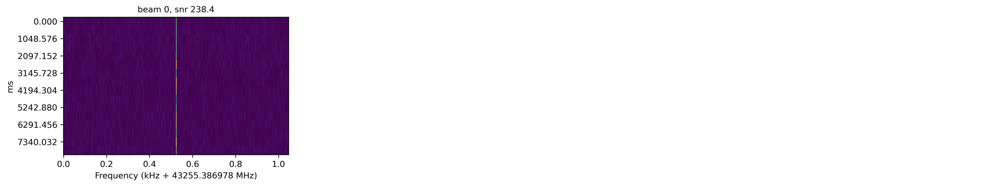

recalculated power: 6.887098e+12
local SNR: 1104.5736973114394


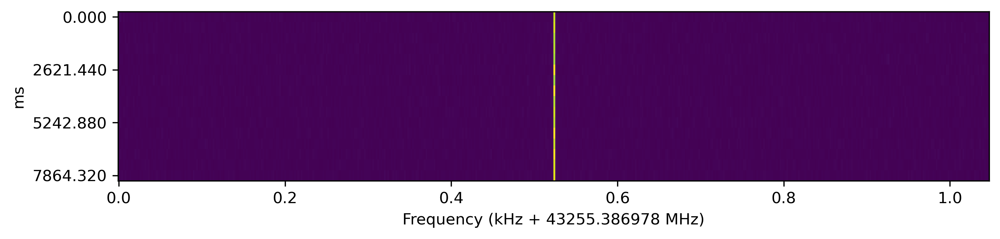

recalculated power: 6.887098e+12
local SNR: 1104.573697311438


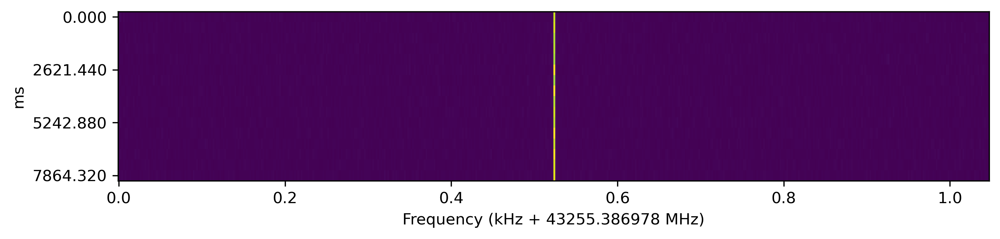

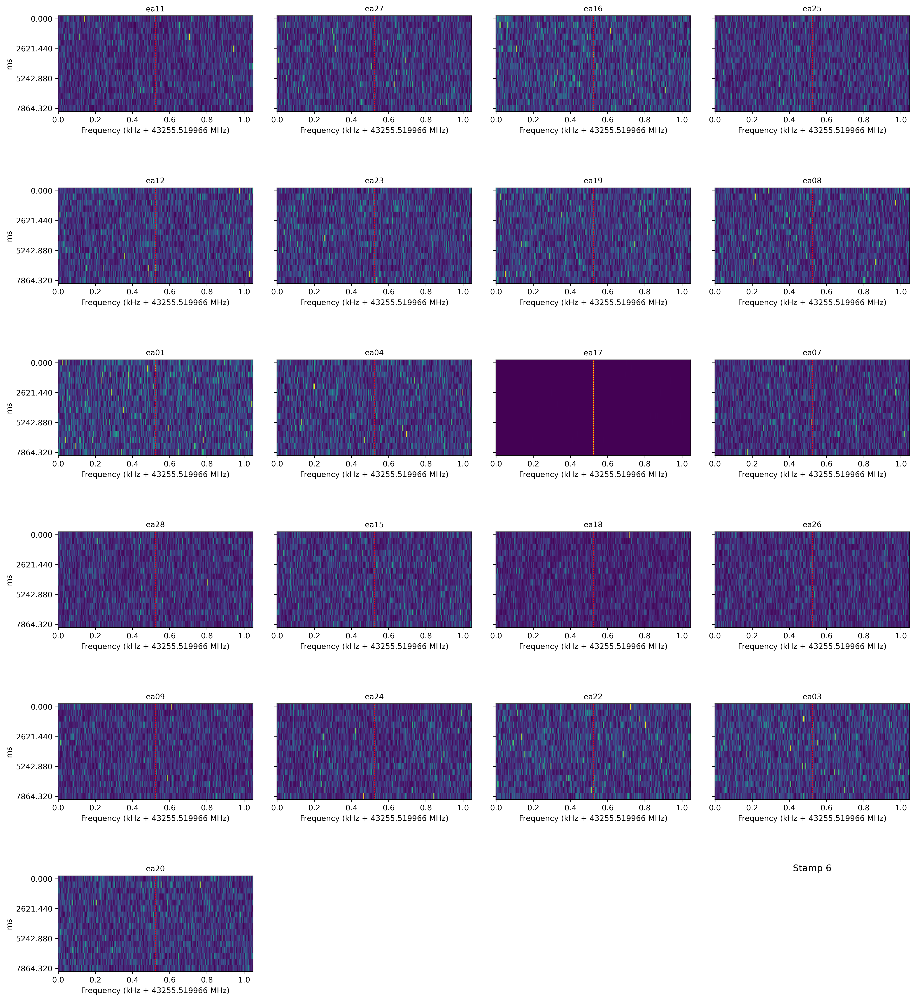

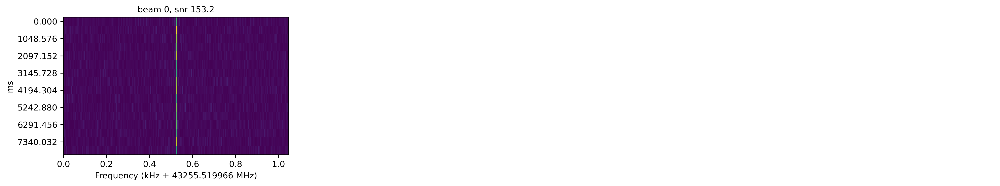

recalculated power: 6.228162e+12
local SNR: 825.8472144741897


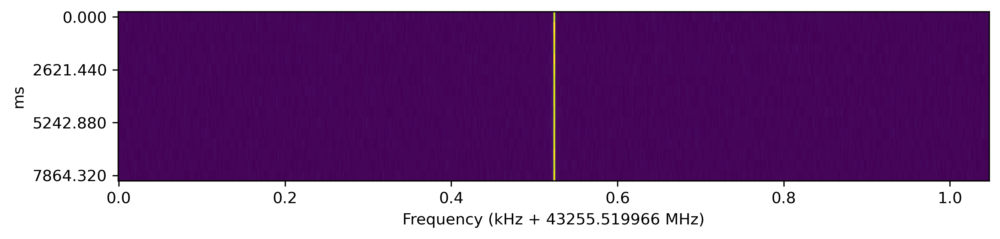

recalculated power: 6.228162e+12
local SNR: 825.8472144741902


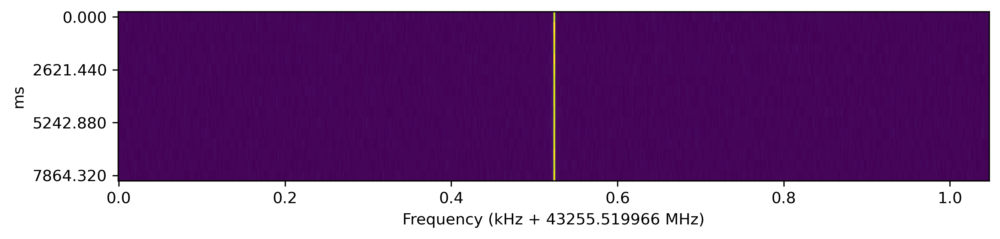

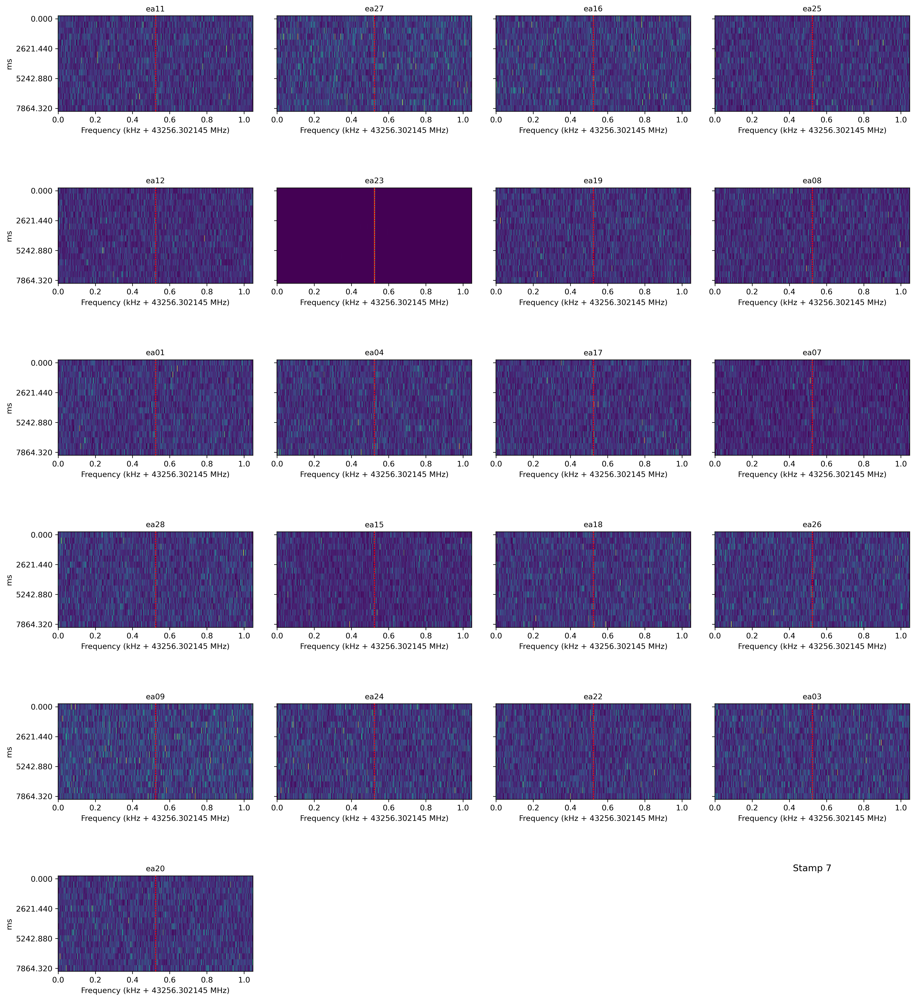

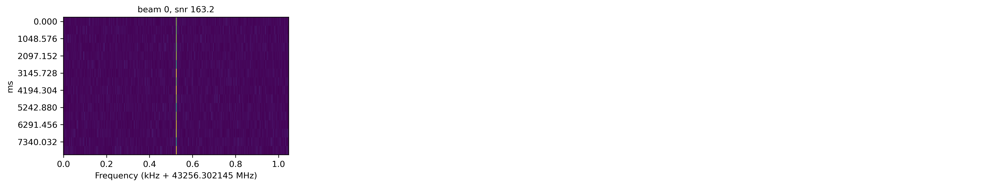

recalculated power: 5.198654e+12
local SNR: 860.328028620298


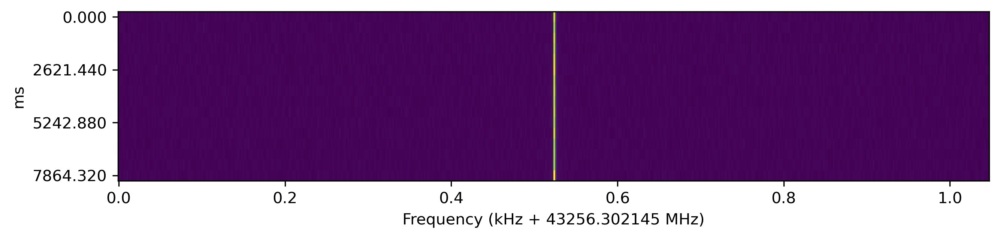

recalculated power: 5.198654e+12
local SNR: 860.3280286202986


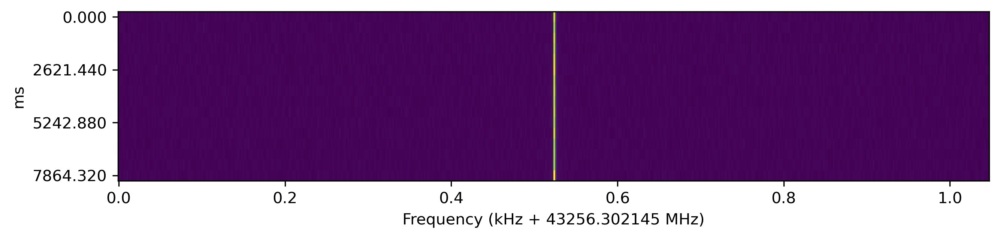

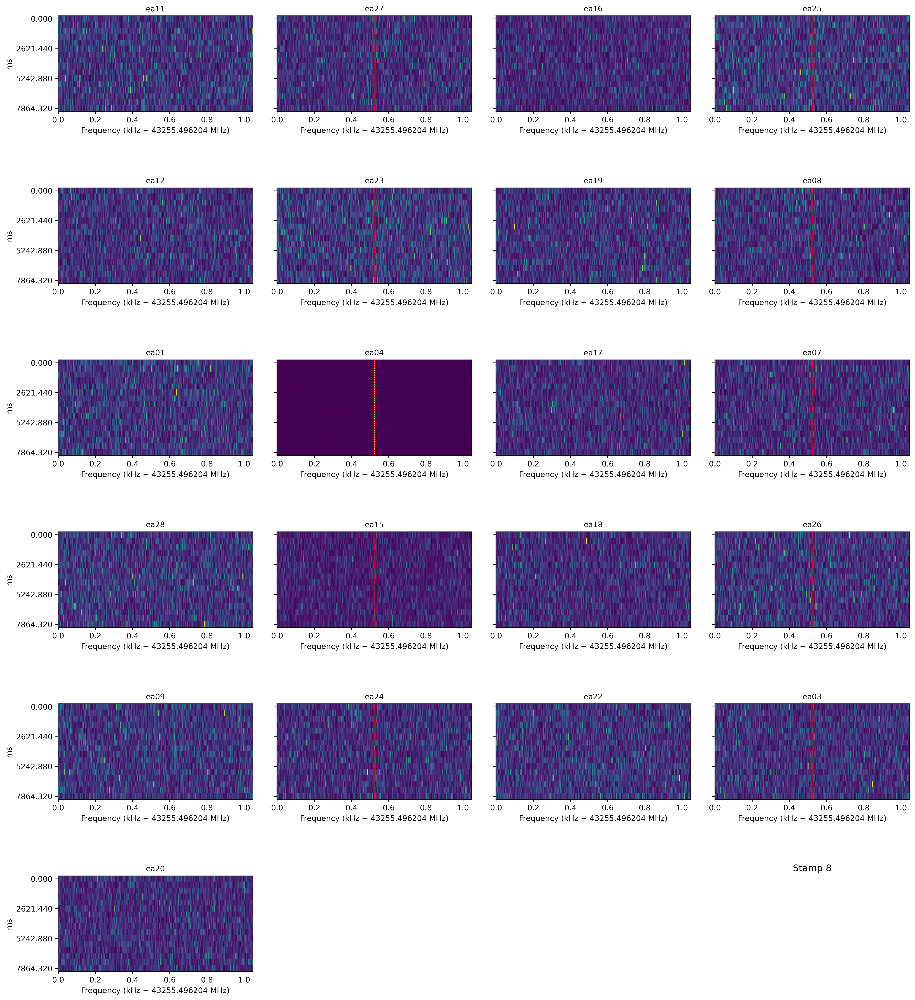

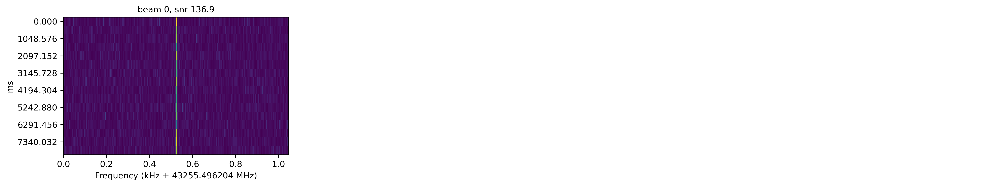

recalculated power: 3.862411e+12
local SNR: 518.068525141416


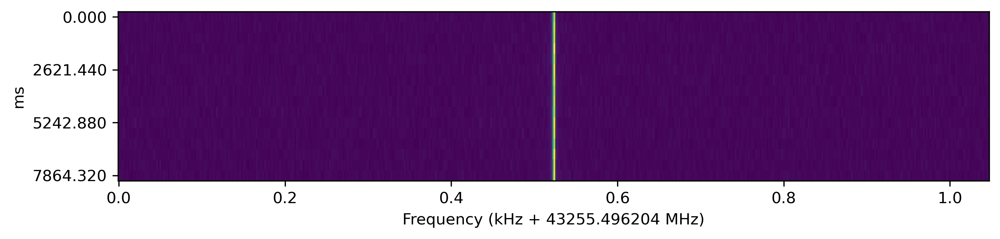

recalculated power: 3.862411e+12
local SNR: 518.0685251414155


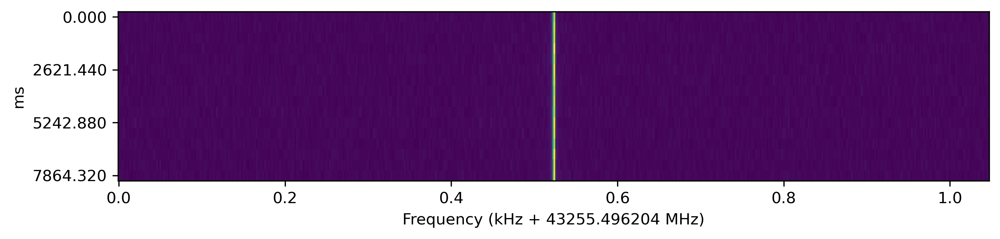

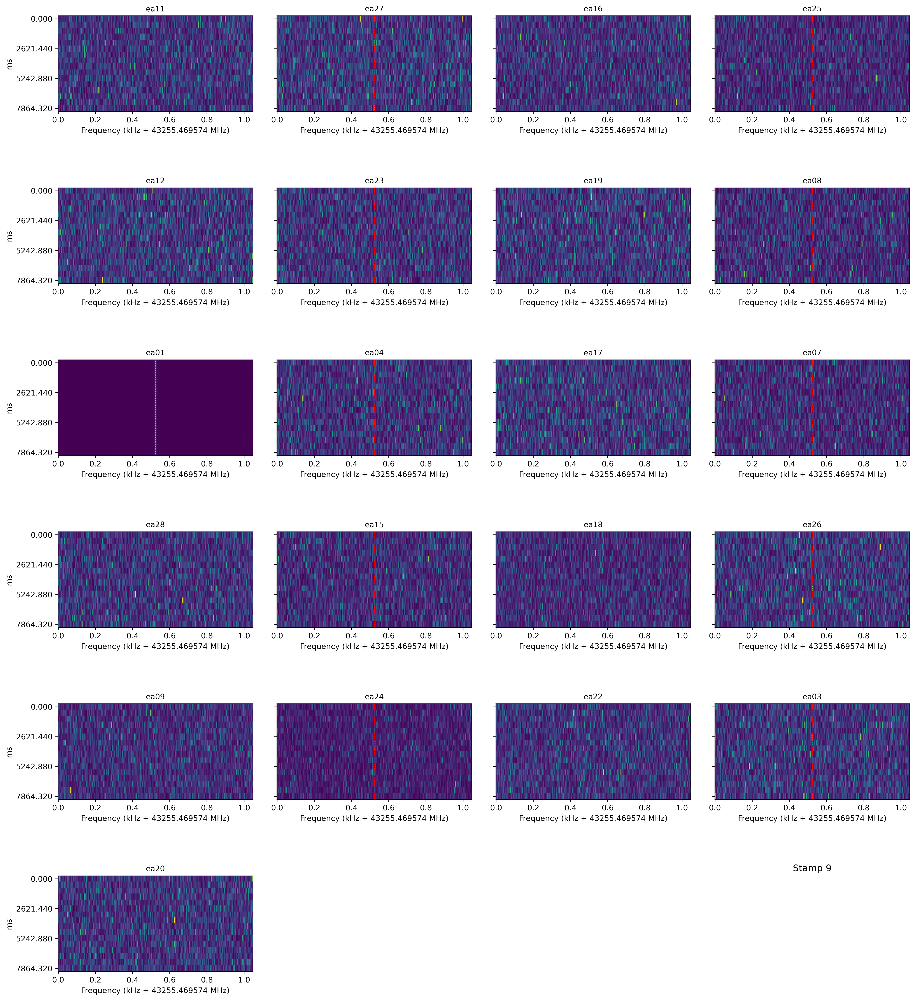

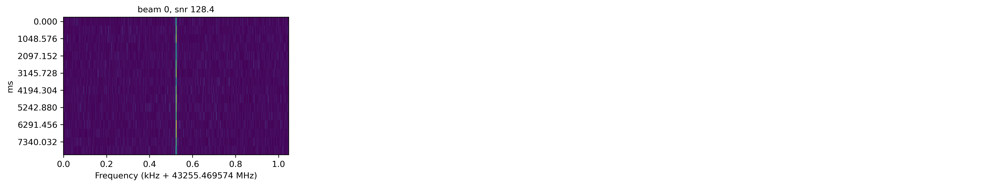

recalculated power: 3.826173e+12
local SNR: 600.2674422509866


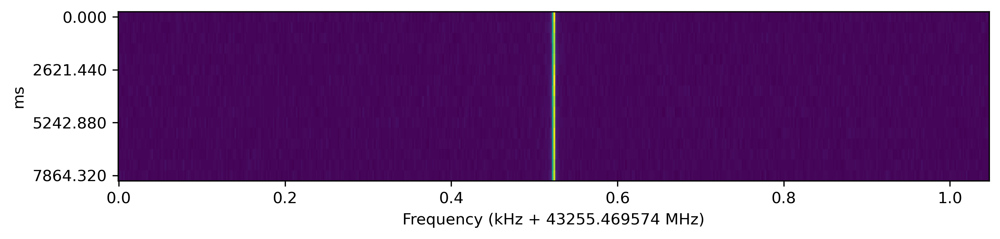

recalculated power: 3.826173e+12
local SNR: 600.2674422509867


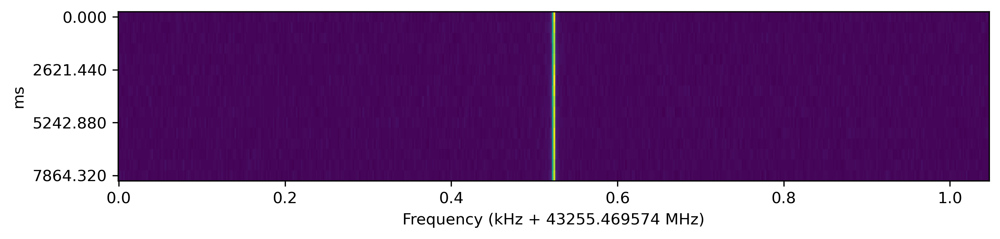

In [26]:
# I guess just look at all the antennas
for i, stamp in enumerate(stamps):
    stamp.show_antennas(title=f"Stamp {i}", show_signal=True)
    stamp.show_beams()
    stamp.show_classic_incoherent()
    stamp.show_weighted_incoherent()

In [30]:
n_beams = [stamp.recipe.nbeams for stamp in stamps]
print(n_beams)

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
